# Step-1 Reading and Understanding Data

1)Importing data using the pandas library
2)Understanding the structure of the data

In [127]:
# !pip install numpy
# !pip install pandas
# !pip install matplotlib
# !pip install dataprep
# !pip install sklearn
# !pip install seaborn
# !pip install xgboost

## Importing the Libraries

In [128]:
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from dataprep.eda import create_report

## Load data into the data frame

In [129]:
data = pd.read_csv("C:\\Users\\vishw\\OneDrive\\Desktop\\vehicles.csv")
data.head()

,id,first_date_seen,last_date_seen,vin,year,make,model,trim,mileage,price,...,engine,passengers,description,carfax_url,is_private,seller_name,city,province,longitude,latitude
0,243517,2021-04-05,2021-05-03,2g2wp552071227768,2007,Pontiac,Grand Prix,4dr Sdn,166014.0,3000.0,...,NaN,NaN,"Pontiac Grand Prix 2007, mint condition, clean...",NaN,True,Private Seller,MISSISSAUGA,ON,-79.608894,43.531761
1,341545,2021-04-16,2021-05-03,5FRYD4H26GB501859,2016,Acura,MDX,AWD|LEATHER|SUN ROOF|BACK UP CAM|HEATED SEATS|...,97902.0,24989.0,...,3.5L 6cyl,7.0,2016 Acura MDX SH-AWD equipped with 3.5L V6 en...,https://vhr.carfax.ca/main?id=19Q9m3cFZqcImHGA...,False,Gorrud's Auto Group,Milton,ON,-79.889107,43.525890
2,345845,2021-04-16,2021-05-03,NaN,2005,Infiniti,G35X,Sedan,108000.0,6400.0,...,NaN,NaN,"Runs very smooth just safetied last week, no d...",NaN,True,Private Seller,MISSISSAUGA,ON,-79.594269,43.619488
3,254761,2021-04-08,2021-05-03,1FTFW1EF1GFC52035,2016,Ford,F-150,XL,186750.0,33821.0,...,5.0L 8cyl,NaN,"At Barrie Ford, we've proudly dedicated oursel...",https://vhr.carfax.ca/main?id=sdxVNAZePXjizBpB...,False,BARRIE FORD,Barrie,ON,-79.690971,44.333801
4,256183,2021-04-08,2021-05-03,2HKRM4H50FH112277,2015,Honda,CR-V,"EX, AWD, One Owner, Accident Free & Certified!",124394.0,17443.0,...,2.4,5.0,"EX, AWD, Cloth Interior, Power Drivers Seat, H...",https://vhr.carfax.ca/main?id=PuOEHO4lvLFFsJ8X...,False,TOP PICKS AUTO SALES,North Bay,ON,-79.452217,46.290520


## The above dataset is a Vehicle Dataset for 1 month . Main task in this project is to build a Price Prediction Model for various different cars

## No. of rows and columns in the dataframe intially

In [130]:
data.shape

(52236, 25)

## Checking no. of rows and datatype of every column

In [131]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52236 entries, 0 to 52235
Data columns (total 25 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   id               52236 non-null  int64  
 1   first_date_seen  52236 non-null  object 
 2   last_date_seen   52236 non-null  object 
 3   vin              41662 non-null  object 
 4   year             52236 non-null  int64  
 5   make             52236 non-null  object 
 6   model            52236 non-null  object 
 7   trim             48507 non-null  object 
 8   mileage          52129 non-null  float64
 9   price            52232 non-null  float64
 10  color            48810 non-null  object 
 11  body_type        48624 non-null  object 
 12  drivetrain       49503 non-null  object 
 13  transmission     50119 non-null  object 
 14  fuel_type        51012 non-null  object 
 15  engine           39242 non-null  object 
 16  passengers       21987 non-null  float64
 17  description 

In [132]:
data.dtypes

id                   int64
first_date_seen     object
last_date_seen      object
vin                 object
year                 int64
make                object
model               object
trim                object
mileage            float64
price              float64
color               object
body_type           object
drivetrain          object
transmission        object
fuel_type           object
engine              object
passengers         float64
description         object
carfax_url          object
is_private            bool
seller_name         object
city                object
province            object
longitude          float64
latitude           float64
dtype: object

## No. of Null Values in every column in the dataframe

In [133]:
print('Null Values')
print(data.isnull().sum())

Null Values
id                     0
first_date_seen        0
last_date_seen         0
vin                10574
year                   0
make                   0
model                  0
trim                3729
mileage              107
price                  4
color               3426
body_type           3612
drivetrain          2733
transmission        2117
fuel_type           1224
engine             12994
passengers         30249
description         4237
carfax_url         26872
is_private             0
seller_name           16
city                   0
province               0
longitude              0
latitude               0
dtype: int64


# Step-2 Data Cleaning and Preparation

## Checking the duplicate rows in the dataframe

In [134]:
data.loc[data.duplicated()]

,id,first_date_seen,last_date_seen,vin,year,make,model,trim,mileage,price,...,engine,passengers,description,carfax_url,is_private,seller_name,city,province,longitude,latitude


## No. of Column with different features

In [135]:
data.columns

Index(['id', 'first_date_seen', 'last_date_seen', 'vin', 'year', 'make',
       'model', 'trim', 'mileage', 'price', 'color', 'body_type', 'drivetrain',
       'transmission', 'fuel_type', 'engine', 'passengers', 'description',
       'carfax_url', 'is_private', 'seller_name', 'city', 'province',
       'longitude', 'latitude'],
      dtype='object')

## Missing percentage of data for various features

In [136]:
miss_percent = (data.isnull().sum() / len(data)) * 100
missing = pd.DataFrame({"percent":miss_percent, 'count':data.isnull().sum()}).sort_values(by="percent", ascending=False)
missing.loc[missing['percent'] > 0]

,percent,count
passengers,57.908339,30249
carfax_url,51.443449,26872
engine,24.875565,12994
vin,20.242744,10574
description,8.111264,4237
trim,7.138755,3729
body_type,6.914771,3612
color,6.558695,3426
drivetrain,5.232024,2733
transmission,4.052761,2117


## #Removing columns: Passengers, carfax_url, engine, vin, description, trim, province

In [137]:
data.drop(['passengers', 'carfax_url','engine','vin','description','trim','province'], axis=1, inplace=True)

## Removing rows with missing price, year, mileage, drivetrain, transmission, fuel_type

In [138]:
data.drop(data[data['price'].isna()].index, inplace = True)
data.drop(data[data['year'].isna()].index, inplace = True)
data.drop(data[data['mileage'].isna()].index, inplace = True)
data.drop(data[data['drivetrain'].isna()].index, inplace = True)
data.drop(data[data['transmission'].isna()].index, inplace = True)
data.drop(data[data['fuel_type'].isna()].index, inplace = True)

## No. of rows and columns in the dataset after cleaning

In [139]:
data.shape

(47566, 18)

In [140]:
data.head()

,id,first_date_seen,last_date_seen,year,make,model,mileage,price,color,body_type,drivetrain,transmission,fuel_type,is_private,seller_name,city,longitude,latitude
0,243517,2021-04-05,2021-05-03,2007,Pontiac,Grand Prix,166014.0,3000.0,Blue,Sedan,FWD,Automatic,Gasoline,True,Private Seller,MISSISSAUGA,-79.608894,43.531761
1,341545,2021-04-16,2021-05-03,2016,Acura,MDX,97902.0,24989.0,Lunar Silver Metallic,SUV,AWD,9 Speed Automatic,Premium Unleaded,False,Gorrud's Auto Group,Milton,-79.889107,43.525890
2,345845,2021-04-16,2021-05-03,2005,Infiniti,G35X,108000.0,6400.0,Gold,Sedan,AWD,Automatic,Gasoline,True,Private Seller,MISSISSAUGA,-79.594269,43.619488
3,254761,2021-04-08,2021-05-03,2016,Ford,F-150,186750.0,33821.0,Grey,Truck,4x4,6 Speed Automatic,Gas,False,BARRIE FORD,Barrie,-79.690971,44.333801
4,256183,2021-04-08,2021-05-03,2015,Honda,CR-V,124394.0,17443.0,White,SUV,AWD,Automatic,Gas,False,TOP PICKS AUTO SALES,North Bay,-79.452217,46.290520


## Feature Engineering

## Calculating difference with first_date_seen and last_date_seen i.e. car arrived and sold/unsold

In [141]:
data['first_date_seen'] = pd.to_datetime(data['first_date_seen'])
data['last_date_seen'] = pd.to_datetime(data['last_date_seen'])
data['Difference'] = abs(data['first_date_seen'] - data['last_date_seen']).dt.days

## Creating age of car from year i.e. car manufactured date

In [142]:
data['age_of_car'] = 2021 - data['year']

In [143]:
data.head()

,id,first_date_seen,last_date_seen,year,make,model,mileage,price,color,body_type,drivetrain,transmission,fuel_type,is_private,seller_name,city,longitude,latitude,Difference,age_of_car
0,243517,2021-04-05,2021-05-03,2007,Pontiac,Grand Prix,166014.0,3000.0,Blue,Sedan,FWD,Automatic,Gasoline,True,Private Seller,MISSISSAUGA,-79.608894,43.531761,28,14
1,341545,2021-04-16,2021-05-03,2016,Acura,MDX,97902.0,24989.0,Lunar Silver Metallic,SUV,AWD,9 Speed Automatic,Premium Unleaded,False,Gorrud's Auto Group,Milton,-79.889107,43.525890,17,5
2,345845,2021-04-16,2021-05-03,2005,Infiniti,G35X,108000.0,6400.0,Gold,Sedan,AWD,Automatic,Gasoline,True,Private Seller,MISSISSAUGA,-79.594269,43.619488,17,16
3,254761,2021-04-08,2021-05-03,2016,Ford,F-150,186750.0,33821.0,Grey,Truck,4x4,6 Speed Automatic,Gas,False,BARRIE FORD,Barrie,-79.690971,44.333801,25,5
4,256183,2021-04-08,2021-05-03,2015,Honda,CR-V,124394.0,17443.0,White,SUV,AWD,Automatic,Gas,False,TOP PICKS AUTO SALES,North Bay,-79.452217,46.290520,25,6


## Car Situation i.e. whether the car is sold/unsold based on last_date_seen

In [144]:
data['Car_situation'] = np.where(data['last_date_seen'] == '2021-05-03' , 'Unsold', 'Sold')

## Removing featuress: id, first_date_seen, last_date_seen, model, color, seller_name for model creation

In [145]:
data.drop(['id', 'first_date_seen','last_date_seen','model','color','seller_name'], axis=1, inplace=True)

## Removing Outliers from the data on the basis of years (considering years from 2000 to 2021)

In [146]:
data = data[data['year'] >= 2000]
data = data[data['year'] <= 2021]
data.shape

(46869, 15)

## Grouping transmission column into Automatic and Manual

In [147]:
data['transmission'] = data['transmission'].str.replace(r'(^.*Automatic.*$)', 'Automatic')
data['transmission'] = data['transmission'].str.replace(r'(^.*CVT.*$)', 'Automatic')
data['transmission'] = data['transmission'].str.replace(r'(^.*Manual.*$)', 'Manual')
data['transmission'] = data['transmission'].str.replace(r'(^.*Sequential.*$)', 'Manual')

## Grouping Fuel Types into Gasoline, Hybrid, Electric, Diesel, Others

In [148]:
data['fuel_type'] = data['fuel_type'].str.replace(r'(^.*Hybrid.*$)', 'Hybrid')
data['fuel_type'] = data['fuel_type'].str.replace(r'(^.*Gas.*$)', 'Gasoline')
data['fuel_type'] = data['fuel_type'].str.replace(r'(^.*Unleaded.*$)', 'Gasoline')
data['fuel_type'] = data['fuel_type'].str.replace(r'(^.*Flexible.*$)', 'Gasoline')
data['fuel_type'] = data['fuel_type'].str.replace(r'(^.*Other.*$)', 'Other')

## Grouping Seller Name into Private Seller and Other Seller

In [149]:
data['seller_type'] = np.where(data['is_private'] == True, 'Private Seller', 'Other Seller')

## Dropping feature: is_private after classifying into binary

In [150]:
data.drop(['is_private'], axis=1, inplace=True)

## Grouping various body types of cars

In [151]:
data['body_type'] = data['body_type'].str.replace(r'(^.*Truck.*$)', 'Truck')
data['body_type'] = data['body_type'].str.replace(r'(^.*Cab.*$)', 'Cab')
data['body_type'] = data['body_type'].str.replace(r'(^.*Wagon.*$)', 'Wagon')
data[['body_type']] = data[['body_type']] .replace(['Compact','Sedan'],'Sedan')
data[['body_type']] = data[['body_type']] .replace(['Super Crew','Roadster','Avant','Cutaway'],'Others')

## Grouping drivetrains feature of cars

In [152]:
data['drivetrain'] = data['drivetrain'].str.replace(r'(^.*4.*$)', '4WD')

## Finding no. of missing values in the dataset

In [153]:
miss_percent = (data.isnull().sum() / len(data)) * 100
missing = pd.DataFrame({"percent":miss_percent, 'count':data.isnull().sum()}).sort_values(by="percent", ascending=False)
missing.loc[missing['percent'] > 0]

,percent,count
body_type,5.86315,2748


## Removing missing values from the dataset

In [154]:
data = data.dropna(how='any',axis=0)

## No. of rows and columns in the dataset after cleaning

In [155]:
data.shape

(44121, 15)

## Though there are 108 Duplicate rows but cannot be removed because there can be multiple cars with same features after cleaning the data or dealer might have multiple cars

In [156]:
data.duplicated().sum()

108

## Calculating Price Percentiles to categorize in 'Low','Medium' and 'High' Groups

In [157]:
print(data.price.describe(percentiles = [0.25,0.33,0.67,0.85,0.90,1]))

count    4.412100e+04
mean     2.568980e+04
std      2.593134e+04
min      1.000000e+02
25%      1.258000e+04
33%      1.500000e+04
50%      2.069000e+04
67%      2.788800e+04
85%      3.999900e+04
90%      4.757700e+04
100%     1.399888e+06
max      1.399888e+06
Name: price, dtype: float64


## Removing Outliers with price <= 1500

In [158]:
data = data[data['price'] >= 1500]

In [159]:
#Grouping Price
data['price_category'] = data['price'].apply(lambda x : "Low" if x < 15000 
                                                     else ("Medium" if 15000 <= x < 30000
                                                           else "High"))

## Calculating Mileage Percentiles to categorize in 'Low','Medium' and 'High' Groups

In [160]:
print(data.mileage.describe(percentiles = [0.25,0.50,0.75,0.85,0.90,1]))

count    4.394500e+04
mean     8.701313e+04
std      7.667328e+04
min      0.000000e+00
25%      3.750000e+04
50%      6.972100e+04
75%      1.220000e+05
85%      1.552982e+05
90%      1.790000e+05
100%     3.965000e+06
max      3.965000e+06
Name: mileage, dtype: float64


## Mileage data is divided into three category using priori

In [161]:
data['mileage_category'] = data['mileage'].apply(lambda x : "Low" if x < 100000 
                                                     else ("Medium" if 100000 <= x < 200000
                                                           else "High"))

## No. of rows and columns in the dataset after adding Price_Category and Mileage_Category

In [162]:
data.shape
data.head()

,year,make,mileage,price,body_type,drivetrain,transmission,fuel_type,city,longitude,latitude,Difference,age_of_car,Car_situation,seller_type,price_category,mileage_category
0,2007,Pontiac,166014.0,3000.0,Sedan,FWD,Automatic,Gasoline,MISSISSAUGA,-79.608894,43.531761,28,14,Unsold,Private Seller,Low,Medium
1,2016,Acura,97902.0,24989.0,SUV,AWD,Automatic,Gasoline,Milton,-79.889107,43.525890,17,5,Unsold,Other Seller,Medium,Low
2,2005,Infiniti,108000.0,6400.0,Sedan,AWD,Automatic,Gasoline,MISSISSAUGA,-79.594269,43.619488,17,16,Unsold,Private Seller,Low,Medium
3,2016,Ford,186750.0,33821.0,Truck,4WD,Automatic,Gasoline,Barrie,-79.690971,44.333801,25,5,Unsold,Other Seller,High,Medium
4,2015,Honda,124394.0,17443.0,SUV,AWD,Automatic,Gasoline,North Bay,-79.452217,46.290520,25,6,Unsold,Other Seller,Medium,Medium


## Quick Exploratory Data Analysis Report with Overview, Interactions, Correlations, Missing Values

#### Before applying models, looking at the features and also relationship with each other by visualization of data.

  0%|          | 0/1800 [00:00<?, ?it/s]

DataPrep Report
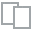
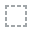
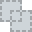
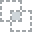
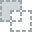
...
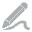
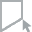
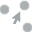
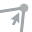
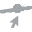

In [163]:
create_report(data)

## Key Findings:
1)Correlation between Price and Mileage according to Pearson test is 0.37  i.e. moderate relationship.
2)Correlation between Price and Age of Car according to Pearson test is 0.39 i.e. moderate relationship.
3)Correlation between Age of Car and Mileage according to Pearson test is 0.65 i.e. Strong relationship.

# Step-3 Exploratory Data Analysis

## Finding relationship between Price and Mileage in the dataset

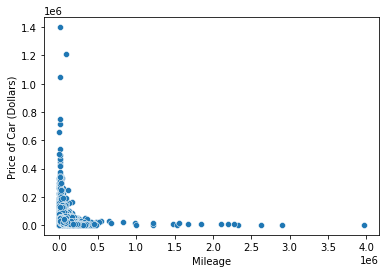

In [164]:
plt1 = sns.scatterplot(x = 'mileage', y = 'price', data = data)
plt1.set_xlabel('Mileage')
plt1.set_ylabel('Price of Car (Dollars)')
plt.show()

# Visualizing the data

## Finding the distribution of Price and Mileage  by creating Distribution Plot

Text(0.5, 1.0, 'Distribution plot for Mileage')

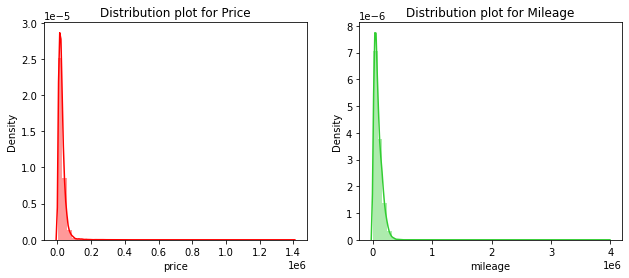

In [165]:
plt.figure(figsize=(16,4))
plt.subplot(1, 3, 1)
#Distribution plot for Price
axis = sns.distplot(data['price'], color = 'red')
plt.title("Distribution plot for Price")
plt.subplot(1, 3, 2)
#Distribution plot for Mileage
axis = sns.distplot(data['mileage'], color='limegreen')
plt.title("Distribution plot for Mileage")

#### Findings: 
1) The plot seems to be right skewed i.e. most prices in the dataset are low.
2) There is a significant difference between the mean and median of the price distribution.

## Creating Body Class v/s Price plot and Drivetrain v/s Price plot

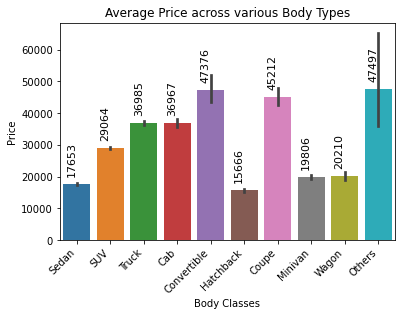

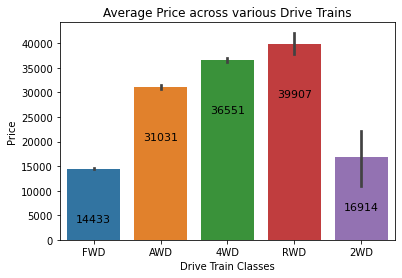

In [166]:
#Body Class v/s Price
axis = sns.barplot(x="body_type", y="price", data=data)
for i in axis.patches:
             axis.annotate("%.f" % i.get_height(), (i.get_x() + i.get_width() / 2., i.get_height()),
                 ha='right', va='center', fontsize=11, color='black', xytext=(0, 25), rotation = 90,
                 textcoords='offset points')
plt.xticks(rotation=45, horizontalalignment='right')
plt.xlabel('Body Classes')
plt.ylabel('Price')
plt.title('Average Price across various Body Types')
plt.show()
#Drive Train Class v/s Price
axis = sns.barplot(x="drivetrain", y="price", data=data)
for i in axis.patches:
             axis.annotate("%.f" % i.get_height(), (i.get_x() + i.get_width() / 2., i.get_height()),
                 ha='center', va='center', fontsize=11, color='black', xytext=(0, -50), 
                 textcoords='offset points')
plt.xlabel('Drive Train Classes')
plt.ylabel('Price')
plt.title('Average Price across various Drive Trains')
plt.show()

## Creating Transmission v/s Price plot and Sellers v/s Price plot

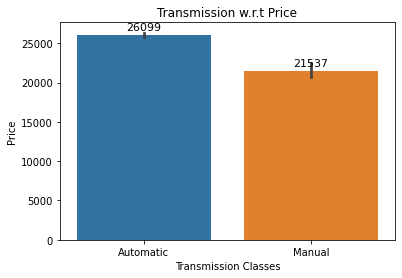

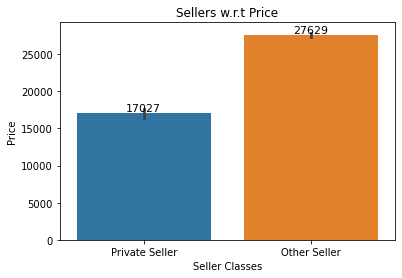

In [167]:
#Transmission v/s Price
axis = sns.barplot(x="transmission", y="price", data=data)
for i in axis.patches:
             axis.annotate("%.f" % i.get_height(), (i.get_x() + i.get_width() / 2., i.get_height()),
                 ha='center', va='center', fontsize=11, color='black', xytext=(0, 7),
                 textcoords='offset points')
plt.xlabel('Transmission Classes')
plt.ylabel('Price')
plt.title('Transmission w.r.t Price')
plt.show()
#Sellers v/s Price
axis = sns.barplot(x="seller_type", y="price", data=data)
for i in axis.patches:
             axis.annotate("%.f" % i.get_height(), (i.get_x() + i.get_width() / 2., i.get_height()),
                 ha='center', va='center', fontsize=11, color='black', xytext=(0, 5),
                 textcoords='offset points')
plt.xlabel('Seller Classes')
plt.ylabel('Price')
plt.title('Sellers w.r.t Price')
plt.show()

## Creating Body Class v/s Mileage and Drivetrain Class v/s Mileage plot

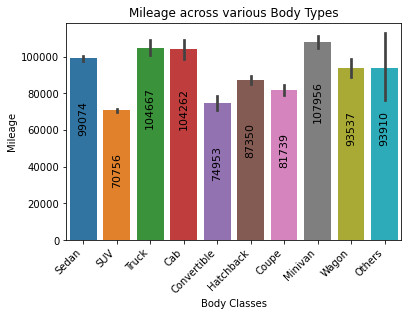

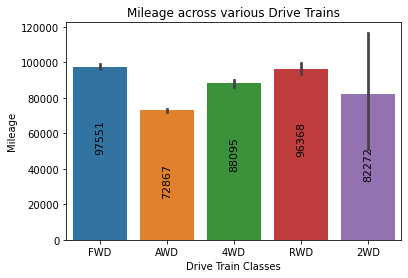

In [168]:
#Body Class v/s Mileage
#plt.rcParams["figure.figsize"] = (20,3)
axis = sns.barplot(x="body_type", y="mileage", data=data)
for i in axis.patches:
             axis.annotate("%.0f" % i.get_height(), (i.get_x() + i.get_width() / 2., i.get_height()),
                 ha='center', va='center', fontsize=11, color='black', xytext=(0, -60), rotation = 90,
                 textcoords='offset points')
plt.xticks(rotation=45, horizontalalignment='right')
plt.xlabel('Body Classes')
plt.ylabel('Mileage')
plt.title('Mileage across various Body Types')
plt.show()
#Drive Train Class v/s Mileage
axis = sns.barplot(x="drivetrain", y="mileage", data=data)
for i in axis.patches:
             axis.annotate("%.0f" % i.get_height(), (i.get_x() + i.get_width() / 2., i.get_height()),
                 ha='center', va='center', fontsize=11, color='black', xytext=(0, -70), rotation = 90,
                 textcoords='offset points')
plt.xlabel('Drive Train Classes')
plt.ylabel('Mileage')
plt.title('Mileage across various Drive Trains')
plt.show()

## Creating Transmission v/s Mileage and Sellers v/s Mileage plot

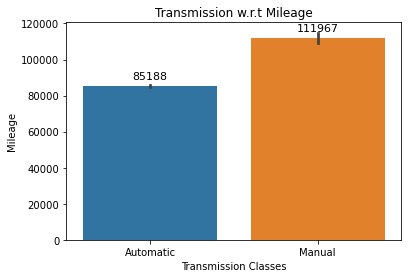

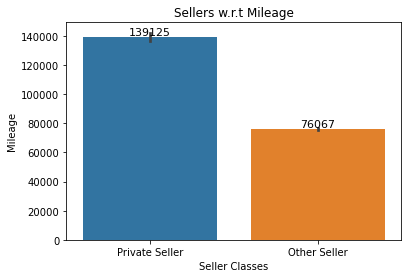

In [169]:
#Transmission v/s Mileage
axis = sns.barplot(x="transmission", y="mileage", data=data)
for i in axis.patches:
             axis.annotate("%.0f" % i.get_height(), (i.get_x() + i.get_width() / 2., i.get_height()),
                 ha='center', va='center', fontsize=11, color='black', xytext=(0, 10),
                 textcoords='offset points')
plt.xlabel('Transmission Classes')
plt.ylabel('Mileage')
plt.title('Transmission w.r.t Mileage')
plt.show()
#Sellers v/s Mileage
axis = sns.barplot(x="seller_type", y="mileage", data=data)
for i in axis.patches:
             axis.annotate("%.0f" % i.get_height(), (i.get_x() + i.get_width() / 2., i.get_height()),
                 ha='center', va='center', fontsize=11, color='black', xytext=(0, 5),
                 textcoords='offset points')
plt.xlabel('Seller Classes')
plt.ylabel('Mileage')
plt.title('Sellers w.r.t Mileage')
plt.show()

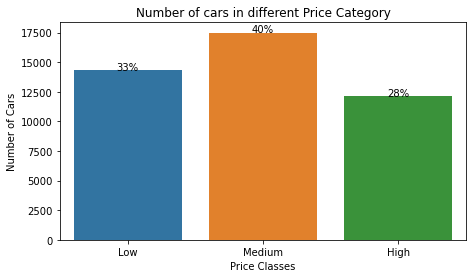

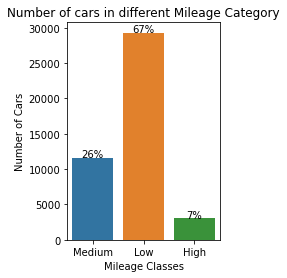

In [170]:
# Number of cars in different Price Category.
plt.figure(figsize=(16,4))
plt.subplot(1, 2, 1)
axis = sns.countplot(x="price_category", data=data)
for i in axis.patches:
    h = i.get_height()
    axis.text(i.get_x()+i.get_width()/2.,h+10,
              '{:1.0f}%'.format(h/len(data)*100),ha="center",fontsize=10) 
plt.xlabel('Price Classes')
plt.ylabel('Number of Cars')
plt.title('Number of cars in different Price Category')
plt.show()
# Number of cars in different Mileage Category
plt.subplot(1, 2, 2)
axis = sns.countplot(x="mileage_category", data=data)
for i in axis.patches:
    h = i.get_height()
    axis.text(i.get_x()+i.get_width()/2.,h+10,
              '{:1.0f}%'.format(h/len(data)*100),ha="center",fontsize=10) 
plt.xlabel('Mileage Classes')
plt.ylabel('Number of Cars')
plt.title('Number of cars in different Mileage Category')
plt.show()


## No. of cars w.r.t Fuel Classes

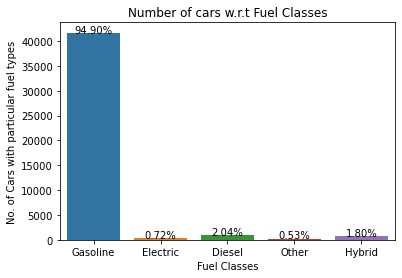

In [171]:
#No. of cars w.r.t Fuel Classes
axis = sns.countplot(x="fuel_type", data=data)
for i in axis.patches:
    h = i.get_height()
    axis.text(i.get_x()+i.get_width()/2.,h+10,
              '{:1.2f}%'.format(h/len(data)*100),ha="center",fontsize=10) 
plt.xlabel('Fuel Classes')
plt.ylabel('No. of Cars with particular fuel types')
plt.title('Number of cars w.r.t Fuel Classes')
plt.show()

## #Top 20 cars w.r.t Car Types

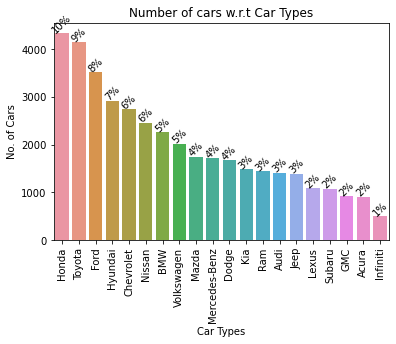

In [172]:
axis = sns.countplot(x="make", data=data,order=data.make.value_counts().iloc[:20].index)
for i in axis.patches:
    h = i.get_height()
    axis.text(i.get_x()+i.get_width()/2.,h+10,
              '{:1.0f}%'.format(h/len(data)*100),ha="center",fontsize=10,rotation = 45) 
plt.xlabel('Car Types')
plt.xticks(rotation=90)
plt.ylabel('No. of Cars')
plt.title('Number of cars w.r.t Car Types')
plt.show()

## Top 20 cities with most cars

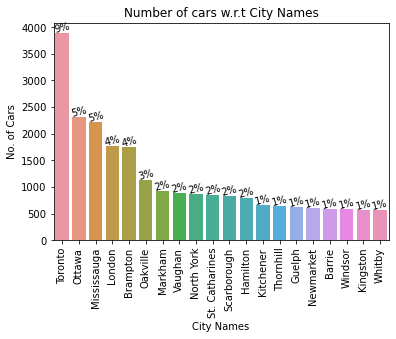

In [173]:
axis = sns.countplot(x="city", data=data,order=data.city.value_counts().iloc[:20].index)
for i in axis.patches:
    h = i.get_height()
    axis.text(i.get_x()+i.get_width()/2.,h+10,
              '{:1.0f}%'.format(h/len(data)*100),ha="center",fontsize=10, rotation = 15)
plt.xlabel('City Names')
plt.xticks(rotation=90)
plt.ylabel('No. of Cars')
plt.title('Number of cars w.r.t City Names')
plt.show()


In [174]:
#data.to_csv(r'C:/Users/vishw/OneDrive/Desktop/try.csv')

# Model Building

## Importing sklearn Library for Model Building and applying functions for fitting the models

In [175]:
import sklearn
from sklearn.model_selection import train_test_split

from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor

from sklearn.model_selection import cross_val_score,KFold
from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error

from sklearn.linear_model import LinearRegression

from sklearn import metrics, model_selection
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV

## Creating a dataframe by copying previous dataframe

In [176]:
df = data.copy()

## Creating target and feature variables from the dataframe

In [177]:
target = data['price']

In [178]:
feature = df.drop(['year','mileage_category','price','city','longitude','latitude','Difference','price_category'], axis=1)

## Performing One Hot encoding on the feature variables for creating training dataset

In [179]:
feature = pd.get_dummies(feature)
feature.head()

,mileage,age_of_car,make_Acura,make_Alfa Romeo,make_Aston Martin,make_Audi,make_BMW,make_Bentley,make_Buick,make_Cadillac,...,transmission_Manual,fuel_type_Diesel,fuel_type_Electric,fuel_type_Gasoline,fuel_type_Hybrid,fuel_type_Other,Car_situation_Sold,Car_situation_Unsold,seller_type_Other Seller,seller_type_Private Seller
0,166014.0,14,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,0,1
1,97902.0,5,1,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,1,0
2,108000.0,16,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,0,1
3,186750.0,5,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,1,0
4,124394.0,6,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,1,0


In [180]:
features=feature.values
target=target.values

## Split data in training and testing data in 80-20 form by random allocation:

In [181]:
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42)

## RandomForesting

In [182]:
RF_regressor=RandomForestRegressor(n_estimators=200,random_state=42,max_depth = 9)
RF_regressor.fit(X_train,y_train)
target_predict=RF_regressor.predict(X_test)

In [183]:
def printAccuracy(regressor):
    print("R2 score of training data: ",r2_score(y_train,regressor.predict(X_train)))
    print("R2 score of testing data: ",r2_score(y_test, target_predict))
    print("Mean Square error of training data: ",mean_squared_error(y_train,regressor.predict(X_train)))
    print("Mean Square error of testing data: ",mean_squared_error(y_test, target_predict))
    print("Mean absolute error of training data: ",mean_absolute_error(y_train,regressor.predict(X_train)))
    print("Mean Absolute error of testing data: ",mean_absolute_error(y_test, target_predict))

In [184]:
printAccuracy(RF_regressor)

R2 score of training data:  0.7175307735441774
R2 score of testing data:  0.7128515731403668
Mean Square error of training data:  202690097.9853497
Mean Square error of testing data:  141533103.6832762
Mean absolute error of training data:  6548.147206829551
Mean Absolute error of testing data:  6480.875917867244


## Checking important features generated in the dataset using Random Forest

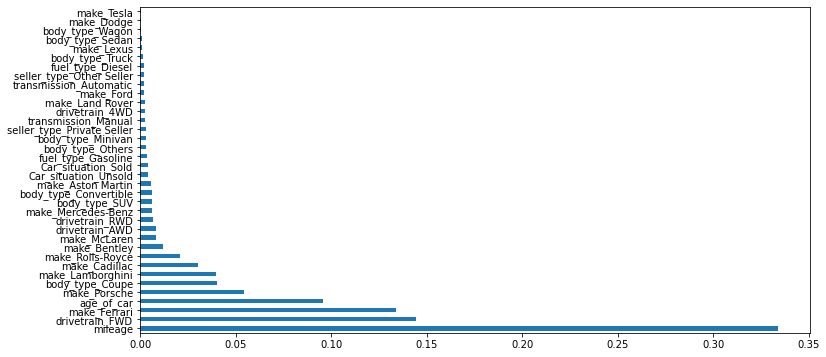

In [185]:
plt.figure(figsize=[12,6])
feat_importances = pd.Series(RF_regressor.feature_importances_, index=feature.columns)
feat_importances.nlargest(36).plot(kind='barh')
plt.show()

## XG Boost

In [186]:
import xgboost as xgb

In [187]:
xgBoost_regressor = xgb.XGBRegressor(colsample_bytree=1,              
                 learning_rate=0.01,
                 max_depth=9,
                 n_estimators=250,                                                                    
                 seed=42)
xgBoost_regressor.fit(X_train,y_train)
target_predict=xgBoost_regressor.predict(X_test)

In [188]:
printAccuracy(xgBoost_regressor)

R2 score of training data:  0.7749779985649867
R2 score of testing data:  0.7494266980232571
Mean Square error of training data:  161467966.2347416
Mean Square error of testing data:  123505524.70994835
Mean absolute error of training data:  5602.112580356127
Mean Absolute error of testing data:  5593.416384210955


## Understanding Feature Importance for XG Boost

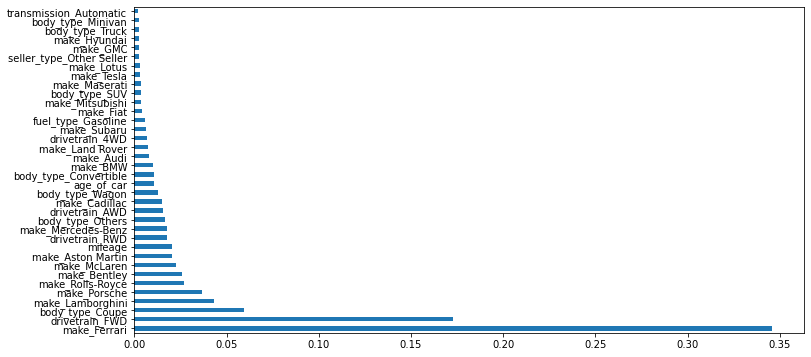

In [189]:
plt.figure(figsize=[12,6])
feat_importances = pd.Series(xgBoost_regressor.feature_importances_, index=feature.columns)
feat_importances.nlargest(36).plot(kind='barh')
plt.show()

# Conclusion

#### 1) Applying Random Forest and XG Boost on the dataset because we are predicting price with nearly 86 features so other algorithms would not fulfil the purpose.
#### 2) As the test accuracy and train accuracy are pretty similar for both the models so it is neither underfitting nor overfitting.

# Future Scope

#### 1) Perform Hyperparameter Tuning while selecting the parameter for Random Forest and XG Boost.
#### 2) Train the model using Neural Networks.
